In [1]:
# 二维卷积算子
import paddle
import paddle.nn as nn

class Conv2D(nn.Layer):
    def __init__(self, kernel_size, 
                 weight_attr = paddle.ParamAttr(initializer=nn.initializer.Assign(value=[[0., 1.], [2., 3.]]))):
        super(Conv2D, self).__init__()
        # 使用'paddle.create_parameter'创建卷积核
        # 使用'paddle.ParamAttr'进行参数初始化
        self.weight = paddle.create_parameter(shape=[kernel_size, kernel_size], dtype="float32", attr=weight_attr)

    def forward(self, X):
        """
        输入：
            - X：输入矩阵，shape=[B, M, N]，B为样本数量
        输出：
            - output：输出矩阵
        """
        u, v = self.weight.shape
        output = paddle.zeros([X.shape[0], X.shape[1]-u+1, X.shape[2]-v+1])
        for i in range(output.shape[1]):
            for j in range(output.shape[2]):
                output[:, i, j] = paddle.sum(X[:, i:i+u, j:j+v]*self.weight, axis=[1,2])
        return output
    
# 随机构造一个二维输入矩阵
paddle.seed(100)
inputs = paddle.to_tensor([[[1., 2., 3.], [4., 5., 6.], [7., 8., 9]]])

conv2d = Conv2D(kernel_size=2)
outputs = conv2d(inputs)
print(f"input: {inputs},\noutput:{outputs}")

input: Tensor(shape=[1, 3, 3], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[1., 2., 3.],
         [4., 5., 6.],
         [7., 8., 9.]]]),
output:Tensor(shape=[1, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=False,
       [[[25., 31.],
         [43., 49.]]])


In [2]:
# 带步长和零填充的二维卷积算子

class Conv2D(nn.Layer):
    def __init__(self, kernel_size, stride=1, padding=0,
                 weight_attr=paddle.ParamAttr(initializer=nn.initializer.Constant(value=1.0))):
        super(Conv2D, self).__init__()
        self.weight = paddle.create_parameter(shape=[kernel_size,kernel_size], dtype="float32", attr=weight_attr)

        # 步长
        self.stride = stride
        # 零填充
        self.padding = padding

    def forward(self, X):
        # 零填充
        new_X = paddle.zeros([X.shape[0], X.shape[1]+2*self.padding, X.shape[2]+2*self.padding])
        new_X[:, self.padding:X.shape[1]+self.padding, self.padding:X.shape[2]+self.padding] = X
        u, v = self.weight.shape
        output_w = (new_X.shape[1] - u) // self.stride + 1
        output_h = (new_X.shape[2] - v) // self.stride + 1
        output = paddle.zeros([X.shape[0], output_w, output_h])
        for i in range(0, output.shape[1]):
            for j in range(0, output.shape[2]):
                output[:, i, j] = paddle.sum(new_X[:, self.stride*i:self.stride*i+u, self.stride*j:self.stride*j+v]*self.weight, axis=[1,2])
        return output

inputs = paddle.randn(shape=[2, 8, 8])
conv2d_padding = Conv2D(kernel_size=3, padding=1)
outputs = conv2d_padding(inputs)
print(f"When kernel_size=3, padding=1, stride=1, input's shape: {inputs.shape}, output's shape: {outputs.shape}")
conv2d_padding = Conv2D(kernel_size=3, stride=2, padding=1)
outputs = conv2d_padding(inputs)
print(f"When kernel_size=3, padding=1, stride=2, input's shape: {inputs.shape}, output's shape: {outputs.shape}")               
                

When kernel_size=3, padding=1, stride=1, input's shape: [2, 8, 8], output's shape: [2, 8, 8]
When kernel_size=3, padding=1, stride=2, input's shape: [2, 8, 8], output's shape: [2, 4, 4]


bf to_tensor, inputs: [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
bf unsqueeze, inputs: Tensor(shape=[256, 256], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]])
af unsqueeze, inputs: Tensor(shape=[1, 256, 256], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]]])


d:\Anaconda3\lib\site-packages\fontTools\misc\py23.py:11: DeprecationWarning: The py23 module has been deprecated and will be removed in a future release. Please update your code.
  warnings.warn(


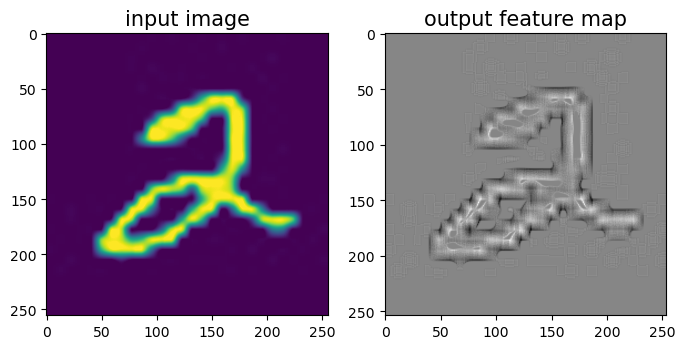

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# 读取图片
img = Image.open('./number.jpg').resize((256,256))

# 设置卷积核参数
w = np.array([[-1,-1,-1], [-1,8,-1], [-1,-1,-1]], dtype='float32')
# 创建卷积算子，卷积核大小为3x3，并使用上面的设置好的数值作为卷积核权重的初始化参数
conv = Conv2D(kernel_size=3, stride=1, padding=0,
              weight_attr=paddle.ParamAttr(initializer=nn.initializer.Assign(value=w)))

# 将读入的图片转化为float32类型的numpy.ndarray
inputs = np.array(img).astype('float32')
print("bf to_tensor, inputs:", inputs)

# 将图片转化成Tensor
inputs = paddle.to_tensor(inputs)
print("bf unsqueeze, inputs:", inputs)
inputs = paddle.unsqueeze(inputs, axis=0)
print("af unsqueeze, inputs:", inputs)
outputs = conv(inputs)
output = outputs.numpy()

# 可视化结果
plt.figure(figsize=(8,4))
f = plt.subplot(1, 2, 1)
f.set_title("input image", fontsize=15)
plt.imshow(img)
f = plt.subplot(1, 2, 2)
f.set_title("output feature map", fontsize=15)
plt.imshow(outputs.squeeze(), cmap='gray')
plt.savefig('conv-vis.pdf')
plt.show()

In [4]:
class Conv2D(nn.Layer):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0,
                    weight_attr=paddle.ParamAttr(initializer=nn.initializer.Constant(value=1.0)),
                    bias_attr=paddle.ParamAttr(initializer=nn.initializer.Constant(value=0.0))):
        super(Conv2D, self).__init__()
        # 创建卷积核
        self.weight = paddle.create_parameter(shape=[out_channels, in_channels, kernel_size,kernel_size],
                                                dtype='float32',
                                                attr=weight_attr)
        # 创建偏置
        self.bias = paddle.create_parameter(shape=[out_channels, 1],
                                                dtype='float32',
                                                attr=bias_attr)
        self.stride = stride
        self.padding = padding
        # 输入通道数
        self.in_channels = in_channels
        # 输出通道数
        self.out_channels = out_channels

    # 基础卷积运算
    def single_forward(self, X, weight):
        # 零填充
        new_X = paddle.zeros([X.shape[0], X.shape[1]+2*self.padding, X.shape[2]+2*self.padding])
        new_X[:, self.padding:X.shape[1]+self.padding, self.padding:X.shape[2]+self.padding] = X
        u, v = weight.shape
        output_w = (new_X.shape[1] - u) // self.stride + 1
        output_h = (new_X.shape[2] - v) // self.stride + 1
        output = paddle.zeros([X.shape[0], output_w, output_h])
        for i in range(0, output.shape[1]):
            for j in range(0, output.shape[2]):
                output[:, i, j] = paddle.sum(
                    new_X[:, self.stride*i:self.stride*i+u, self.stride*j:self.stride*j+v]*weight, 
                    axis=[1,2])
        return output

    def forward(self, inputs):
        """
        输入：
            - inputs：输入矩阵，shape=[B, D, M, N]
            - weights：P组二维卷积核，shape=[P, D, U, V]
            - bias：P个偏置，shape=[P, 1]
        """
        feature_maps = []
        # 进行多次多输入通道卷积运算
        p=0
        for w, b in zip(self.weight, self.bias): # P个(w,b),每次计算一个特征图Zp
            multi_outs = []
            # 循环计算每个输入特征图对应的卷积结果
            for i in range(self.in_channels):
                single = self.single_forward(inputs[:,i,:,:], w[i])
                multi_outs.append(single)
                print("Conv2D in_channels:",self.in_channels,"i:",i,"single:",single.shape)
            # 将所有卷积结果相加
            feature_map = paddle.sum(paddle.stack(multi_outs), axis=0) + b #Zp
            feature_maps.append(feature_map)
            print("Conv2D out_channels:",self.out_channels, "p:",p,"feature_map:",feature_map.shape)
            p+=1
        # 将所有Zp进行堆叠
        out = paddle.stack(feature_maps, 1) 
        return out

inputs = paddle.to_tensor([[[[0.0, 1.0, 2.0], [3.0, 4.0, 5.0], [6.0, 7.0, 8.0]], [[1.0, 2.0, 3.0], [4.0, 5.0, 6.0], [7.0, 8.0, 9.0]]]])
conv2d = Conv2D(in_channels=2, out_channels=3, kernel_size=2)
print("inputs shape:",inputs.shape)
outputs1 = conv2d(inputs)
print("Conv2D outputs1 shape:",outputs.shape)

# 比较与paddle API运算结果
conv2d_paddle = nn.Conv2D(in_channels=2, out_channels=3, kernel_size=2, weight_attr=paddle.ParamAttr(initializer=nn.initializer.Constant(value=1.0)), bias_attr=paddle.ParamAttr(initializer=nn.initializer.Constant(value=0.0)))
outputs_paddle = conv2d_paddle(inputs)

# 自定义算子运算结果
print('Conv2D outputs1:', outputs1)
# paddle API运算结果
print('nn.Conv2D outputs:', outputs_paddle)

inputs shape: [1, 2, 3, 3]
Conv2D in_channels: 2 i: 0 single: [1, 2, 2]
Conv2D in_channels: 2 i: 1 single: [1, 2, 2]
Conv2D out_channels: 3 p: 0 feature_map: [1, 2, 2]
Conv2D in_channels: 2 i: 0 single: [1, 2, 2]
Conv2D in_channels: 2 i: 1 single: [1, 2, 2]
Conv2D out_channels: 3 p: 1 feature_map: [1, 2, 2]
Conv2D in_channels: 2 i: 0 single: [1, 2, 2]
Conv2D in_channels: 2 i: 1 single: [1, 2, 2]
Conv2D out_channels: 3 p: 2 feature_map: [1, 2, 2]
Conv2D outputs1 shape: [1, 254, 254]
Conv2D outputs1: Tensor(shape=[1, 3, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=False,
       [[[[20., 28.],
          [44., 52.]],

         [[20., 28.],
          [44., 52.]],

         [[20., 28.],
          [44., 52.]]]])
nn.Conv2D outputs: Tensor(shape=[1, 3, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=False,
       [[[[20., 28.],
          [44., 52.]],

         [[20., 28.],
          [44., 52.]],

         [[20., 28.],
          [44., 52.]]]])


In [5]:
class Pool2D(nn.Layer):
    def __init__(self, size=(2,2), mode="max", stride=1):
        super(Pool2D, self).__init__()
        # 池化方式
        self.mode = mode
        self.h, self.w = size
        self.stride = stride

    def forward(self, x):
        output_w = (x.shape[2] - self.w) // self.stride + 1
        output_h = (x.shape[3] - self.h) // self.stride + 1
        output = paddle.zeros([x.shape[0], x.shape[1], output_w, output_h])

        # 池化
        for i in range(output.shape[2]):
            for j in range(output.shape[3]):
                # 最大池化
                if self.mode == 'max':
                    output[:, :, i, j] = paddle.max(x[:, :, self.stride*i:self.stride*i+self.w, self.stride*j:self.stride*j+self.h], axis=[2,3])
                elif self.mode == 'avg':
                    output[:, :, i, j] = paddle.mean(x[:, :, self.stride*i:self.stride*i+self.w, self.stride*j:self.stride*j+self.h], axis=[2,3])
        return output
    
inputs = paddle.to_tensor([[[[1.,2.,3.,4.], [5.,6.,7.,8.], [9.,10.,11.,12],[13.,14.,15.,16.]]]])
pool2d = Pool2D(stride=2)
outputs_max = pool2d(inputs)
print(f"inputs: {inputs.shape}, \noutputs2: {outputs_max.shape}")

# 比较Maxpool2D与paddle API运算结果
maxpool2d_paddle = nn.MaxPool2D(kernel_size=(2,2), stride=2)
outputs_paddle_max = maxpool2d_paddle(inputs)
# 自定义算子运算结果
print("Maxpool2D outputs2:", outputs_max)
# paddle API运算结果
print('nn.Maxpool2D outputs:', outputs_paddle_max)

# 比较Avgpool2D与paddle API运算结果
avgpool2d_paddle = nn.AvgPool2D(kernel_size=(2,2), stride=2)
outputs_paddle_mean = avgpool2d_paddle(inputs)
pool2d1 = Pool2D(mode='avg', stride=2)
outputs_mean = pool2d(inputs)
# 自定义算子运算结果
print('Avgpool2D outputs:', outputs_mean)
# paddle API运算结果
print('nn.Avgpool2D outputs:', outputs_paddle_mean)

inputs: [1, 1, 4, 4], 
outputs2: [1, 1, 2, 2]
Maxpool2D outputs2: Tensor(shape=[1, 1, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[[6. , 8. ],
          [14., 16.]]]])
nn.Maxpool2D outputs: Tensor(shape=[1, 1, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[[6. , 8. ],
          [14., 16.]]]])
Avgpool2D outputs: Tensor(shape=[1, 1, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[[6. , 8. ],
          [14., 16.]]]])
nn.Avgpool2D outputs: Tensor(shape=[1, 1, 2, 2], dtype=float32, place=Place(gpu:0), stop_gradient=True,
       [[[[3.50000000 , 5.50000000 ],
          [11.50000000, 13.50000000]]]])


基于LeNet实现手写体数字识别实验

In [6]:
import json
import gzip

# 打印并观察数据集分布情况
train_set, dev_set, test_set = json.load(gzip.open('./mnist.json.gz'))
train_images, train_labels = train_set[0][:1000], train_set[1][:1000]
dev_images, dev_labels = dev_set[0][:200], dev_set[1][:200]
test_images, test_labels = test_set[0][:200], test_set[1][:200]
train_set, dev_set, test_set = [train_images, train_labels], [dev_images, dev_labels], [test_images, test_labels]
print('Length of train/dev/test set: {}/{}/{}'.format(len(test_set[0]), len(dev_set[0]), len(test_set[0])))

Length of train/dev/test set: 200/200/200


The number in the picture is 5


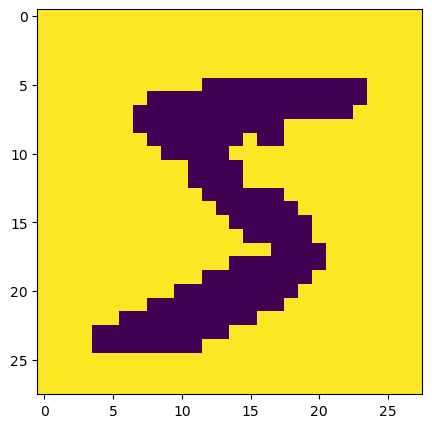

In [7]:
image, label = train_set[0][0], train_set[1][0]
image, label = np.array(image).astype('float32'), int(label)
# 原始图像数据为长度784的行向量，需要调整为[28,28]大小的图像
image = np.reshape(image, [28,28])
image = Image.fromarray(image.astype('uint8'), mode='L')
print(f"The number in the picture is {label}")
plt.figure(figsize=(5, 5))
plt.imshow(image)
plt.savefig('conv-number5.pdf')

In [8]:
# paddle.vision.transforms.Resize调整大小；
# 用paddle.vision.transforms.Normalize进行标准化处理；
# 使用paddle.vision.transforms.Compose将两个预处理操作进行拼接

from paddle.vision.transforms import Compose, Resize, Normalize
# 数据预处理
transforms = Compose([Resize(32), Normalize(mean=[127.5], std=[127.5], data_format='CHW')])


In [9]:
import random
import paddle.io as io

class MNIST_dataset(io.Dataset):
    def __init__(self, dataset, transforms, mode='train'):
        self.mode = mode
        self.dataset = dataset
        self.transforms = transforms
    
    def __getitem__(self, idx):
        # 获取图像和标签
        image, label = self.dataset[0][idx], self.dataset[1][idx]
        image, label = np.array(image).astype('float32'), int(label)
        image = np.reshape(image, [28,28])
        image = Image.fromarray(image.astype('uint8'), mode='L')
        image = self.transforms(image)

        return image, label
    
    def __len__(self):
        return len(self.dataset[0])
    
# 固定随机种子
random.seed(0)
# 加载mnist数据集
train_dataset = MNIST_dataset(dataset=train_set, transforms=transforms, mode='train')
dev_dataset = MNIST_dataset(dataset=dev_set, transforms=transforms, mode='dev')
test_dataset = MNIST_dataset(dataset=test_set, transforms=transforms, mode='test')

In [10]:
# LeNet-5 模型构建
import paddle.nn.functional as F

class Model_LeNet(nn.Layer):
    def __init__(self, in_channels, num_classes=10):
        super(Model_LeNet, self).__init__()
        # 卷积层：输出通道数为6，卷积核大小为5×5
        self.conv1 = Conv2D(in_channels=in_channels, out_channels=6, kernel_size=5, weight_attr=paddle.ParamAttr())
        # 池化层 池化窗户为2*2， 步长为2
        self.pool2 = Pool2D(size=(2,2), mode='max', stride=2)
        # 卷积层：输入通道数为6，输出通道数为16，卷积核大小为5×5，步长为1
        self.conv3 = Conv2D(in_channels=6, out_channels=16, kernel_size=5, stride=1, weight_attr=paddle.ParamAttr())
        # 池化层 池化窗户为2*2， 步长为2
        self.pool4 = Pool2D(size=(2,2), mode='avg', stride=2)
        # 卷积层：输入通道数为16，输出通道数为120，卷积核大小为5×5
        self.conv5 = Conv2D(in_channels=16, out_channels=120, kernel_size=5, stride=1, weight_attr=paddle.ParamAttr())
        # 全连接层：输入神经元为120，输出神经元为84
        self.linear6 = nn.Linear(120,84)
        # 全连接层：输入神经元为84，输出神经元为类别数
        self.linear7 = nn.Linear(84, num_classes)

    def forward(self, x):
        # C1：卷积层+激活函数
        output = F.relu(self.conv1(x))
        # S2: 池化层
        output = self.pool2(output)
        # C3：卷积层+激活函数
        output = F.relu(self.conv3(output))
        # S4: 池化层
        output = self.pool4(output)
        # C5：卷积层+激活函数
        output = F.relu(self.conv5(output))
        # 输入层将数据拉平[B,C,H,W] -> [B,CxHxW]
        output = paddle.squeeze(output, axis=[2,3])
        # F6：全连接层
        output = F.relu(self.linear6(output))
        # F7: 全连接层
        output = self.linear7(output)
        return output

In [11]:
# 这里用np.random创建一个随机数组作为输入数据
inputs = np.random.randn(*[1,1,32,32])
inputs = inputs.astype('float32')

# 创建Model_LeNet类的实例，指定模型名称和分类的类别数目
model = Model_LeNet(in_channels=1, num_classes=10)
# 通过调用LeNet从基类继承的sublayers()函数，查看LeNet中所包含的子层
print(model.sublayers())
x = paddle.to_tensor(inputs)
for item in model.sublayers():
    # item是LeNet类中的一个子层
    # 查看经过子层之后的输出数据形状
    try:
        x = item(x)
    except:
        # 如果是最后一个卷积层输出，需要展平后才可以送入全连接层
        x = paddle.reshape(x, [x.shape[0], -1])
        x = item(x)
    if len(item.parameters())==2:
        # 查看卷积和全连接层的数据和参数的形状，
        # 其中item.parameters()[0]是权重参数w，item.parameters()[1]是偏置参数b
        print(item.full_name(), x.shape, item.parameters()[0].shape, item.parameters()[1].shape)
    else:
        # 池化层无参数
        print(item.full_name(), x.shape)

[Conv2D(), Pool2D(), Conv2D(), Pool2D(), Conv2D(), Linear(in_features=120, out_features=84, dtype=float32), Linear(in_features=84, out_features=10, dtype=float32)]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [1, 28, 28]
conv2d_6 [1, 6, 28, 28] [6, 1, 5, 5] [6, 1]
pool2d_2 [1, 6, 14, 14]
Conv2D in_channels: 6 i: 0 single: [1, 10, 10]
Conv2D in_channels: 6 i: 1 single: [1, 10, 10]
Conv2D in_channels: 6 i: 2 single: [1, 10, 10]
Conv2D in_channels: 6 i: 3 

In [12]:
class Paddle_LeNet(nn.Layer):
    def __init__(self, in_channels, num_classes=10):
        super(Paddle_LeNet, self).__init__()
        # 卷积层：输出通道数为6，卷积核大小为5*5
        self.conv1 = nn.Conv2D(in_channels=in_channels, out_channels=6, kernel_size=5)
        # 池化层：池化窗口2*2 步长为2
        self.pool2 = nn.MaxPool2D(kernel_size=2, stride=2)
        # 卷积层：输入通道数为6，输出通道数为16，卷积核大小为5*5
        self.conv3 = nn.Conv2D(in_channels=6, out_channels=16, kernel_size=5)
        # 池化层：池化窗口2*2 步长为2
        self.pool4 = nn.AvgPool2D(kernel_size=2, stride=2)
        # 卷积层：输入通道数为16，输出通道数为120，卷积核大小为5*5
        self.conv5 = nn.Conv2D(in_channels=16, out_channels=120, kernel_size=5)
        # 全连接层：输入神经元为120，输出神经元为84
        self.linear6 = nn.Linear(in_features=120, out_features=84)
        # 全连接层：输入神经元为84，输出神经元为类别数
        self.linear7 = nn.Linear(in_features=84, out_features=num_classes)

    def forward(self, x):
        # C1：卷积层+激活函数
        output = F.relu(self.conv1(x))
        # S2：池化层
        output = self.pool2(output)
        # C3：卷积层+激活函数
        output = F.relu(self.conv3(output))
        # S4：池化层
        output = self.pool4(output)
        # C5：卷积层+激活函数
        output = F.relu(self.conv5(output))
        # 输入层将数据拉平[B,C,H,W] -> [B,CxHxW]
        output = paddle.squeeze(output, axis=[2,3])
        # F6：全连接层
        output = F.relu(self.linear6(output))
        # F7：全连接层
        output = self.linear7(output)
        return output

In [13]:
import time
# 这里用np.random创建一个随机数组作为测试数据
inputs = np.random.randn(*[1,1,32,32])
inputs = inputs.astype('float32')
x = paddle.to_tensor(inputs)

# 创建Model_LeNet类的实例，指定模型名称和分类的类别数目
model = Model_LeNet(in_channels=1, num_classes=10)
# 创建Paddle_LeNet类的实例，指定模型名称和分类的类别数目
paddle_model = Paddle_LeNet(in_channels=1, num_classes=10)

# 计算Model_LeNet类的运算速度
model_time = 0
for i in range(60):
    start_time = time.time()
    out = model(x)
    end_time = time.time()
    # 预热10次运算， 不计入最终速度统计
    if i < 10:
        continue
    model_time += (end_time - start_time)
avg_model_time = model_time / 50
print('Model_LeNet speed:', avg_model_time, 's')

# 计算Paddle_LeNet类的运算速度
paddle_model_time = 0
for i in range(60):
    start_time = time.time()
    paddle_out = paddle_model(x)
    end_time = time.time()
    # 预热10次运算， 不计入最终速度统计
    if i < 10:
        continue
    paddle_model_time += (end_time - start_time)
avg_paddle_model_time = paddle_model_time / 50
print('Paddle_LeNet speed:', avg_paddle_model_time, 's')

Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [1, 28, 28]
Conv2D in_channels: 6 i: 0 single: [1, 10, 10]
Conv2D in_channels: 6 i: 1 single: [1, 10, 10]
Conv2D in_channels: 6 i: 2 single: [1, 10, 10]
Conv2D in_channels: 6 i: 3 single: [1, 10, 10]
Conv2D in_channels: 6 i: 4 single: [1, 10, 10]
Conv2D in_channels: 6 i: 5 single: [1, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [1, 10, 10]
Conv2D in_channels: 6 i: 0 single: [1, 10, 10]
Conv2D in_channel

In [14]:
# 这里用np.random创建一个随机数组作为测试数据
inputs = np.random.randn(*[1,1,32,32])
inputs = inputs.astype('float32')
x = paddle.to_tensor(inputs)

# 创建Model_LeNet类的实例，指定模型名称和分类的类别数目
model = Model_LeNet(in_channels=1, num_classes=10)
# 获取网络的权重
params = model.state_dict()
# 自定义Conv2D算子的bias参数形状为[out_channels, 1]
# paddle API中Conv2D算子的bias参数形状为[out_channels]
# 需要进行调整后才可以赋值
for key in params:
    if 'bias' in key:
        params[key] = params[key].squeeze()

# 创建Paddle_LeNet类的实例，指定模型名称和分类的类别数目
paddle_model = Paddle_LeNet(in_channels=1, num_classes=10)
# 将Model_LeNet的权重参数赋予给Paddle_LeNet模型，保持两者一致
paddle_model.set_state_dict(params)
# 打印结果保留小数点后6位
paddle.set_printoptions(6)
# 计算Model_LeNet的结果
output = model(x)
print('Model_LeNet output:', output)
# 计算Paddle_LeNet的结果
paddle_output = paddle_model(x)
print('Paddle_LeNet output:', paddle_output)

Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [1, 28, 28]
Conv2D in_channels: 1 i: 0 single: [1, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [1, 28, 28]
Conv2D in_channels: 6 i: 0 single: [1, 10, 10]
Conv2D in_channels: 6 i: 1 single: [1, 10, 10]
Conv2D in_channels: 6 i: 2 single: [1, 10, 10]
Conv2D in_channels: 6 i: 3 single: [1, 10, 10]
Conv2D in_channels: 6 i: 4 single: [1, 10, 10]
Conv2D in_channels: 6 i: 5 single: [1, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [1, 10, 10]
Conv2D in_channels: 6 i: 0 single: [1, 10, 10]
Conv2D in_channel

In [15]:
# 使用 paddle.summaryAPI自动计算参数量
model = Paddle_LeNet(in_channels=1, num_classes=10)
params_info = paddle.summary(model, (1, 1, 32, 32))
print(params_info)

---------------------------------------------------------------------------
 Layer (type)       Input Shape          Output Shape         Param #    
   Conv2D-22      [[1, 1, 32, 32]]      [1, 6, 28, 28]          156      
  MaxPool2D-4     [[1, 6, 28, 28]]      [1, 6, 14, 14]           0       
   Conv2D-23      [[1, 6, 14, 14]]     [1, 16, 10, 10]         2,416     
  AvgPool2D-4    [[1, 16, 10, 10]]      [1, 16, 5, 5]            0       
   Conv2D-24      [[1, 16, 5, 5]]       [1, 120, 1, 1]        48,120     
   Linear-11         [[1, 120]]            [1, 84]            10,164     
   Linear-12         [[1, 84]]             [1, 10]              850      
Total params: 61,706
Trainable params: 61,706
Non-trainable params: 0
---------------------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.06
Params size (MB): 0.24
Estimated Total Size (MB): 0.30
-----------------------------------------------------------------------

In [16]:
# 使用paddle.flopsAPI自动统计计算量
FLOPs = paddle.flops(model, (1, 1, 32, 32), print_detail=True)
print(FLOPs)

<class 'paddle.nn.layer.conv.Conv2D'>'s flops has been counted
Cannot find suitable count function for <class 'paddle.nn.layer.pooling.MaxPool2D'>. Treat it as zero FLOPs.
<class 'paddle.nn.layer.pooling.AvgPool2D'>'s flops has been counted
<class 'paddle.nn.layer.common.Linear'>'s flops has been counted
+--------------+-----------------+-----------------+--------+--------+
|  Layer Name  |   Input Shape   |   Output Shape  | Params | Flops  |
+--------------+-----------------+-----------------+--------+--------+
|  conv2d_21   |  [1, 1, 32, 32] |  [1, 6, 28, 28] |  156   | 122304 |
| max_pool2d_3 |  [1, 6, 28, 28] |  [1, 6, 14, 14] |   0    |   0    |
|  conv2d_22   |  [1, 6, 14, 14] | [1, 16, 10, 10] |  2416  | 241600 |
| avg_pool2d_3 | [1, 16, 10, 10] |  [1, 16, 5, 5]  |   0    |  400   |
|  conv2d_23   |  [1, 16, 5, 5]  |  [1, 120, 1, 1] | 48120  | 48120  |
|  linear_10   |     [1, 120]    |     [1, 84]     | 10164  | 10080  |
|  linear_11   |     [1, 84]     |     [1, 10]     |  8

In [19]:
# 模型训练
import paddle.optimizer as opt
from nndl_5 import RunnerV3, metric

paddle.seed(100)
# 学习率大小
lr = 0.1
# 批次大小
batch_size = 64
# 加载数据
train_loader = io.DataLoader(train_dataset, batch_size= batch_size, shuffle=True)
dev_loader = io.DataLoader(dev_dataset, batch_size=batch_size)
test_loader = io.DataLoader(test_dataset, batch_size=batch_size)
# 定义LeNet网络
# 自定义算子实现的LeNet-5
model = Model_LeNet(in_channels=1, num_classes=10)
# 飞桨API实现的LeNet-5
# model = Paddle_LeNet(in_channels=1, num_classes=10)

# 定义优化器
optimizer = opt.SGD(learning_rate=lr, parameters=model.parameters())
# 定义损失函数
loss_fn = F.cross_entropy
# 定义评价指标
metric = metric.Accuracy(is_logist=True)
# 实例化 RunnerV3 类，并传入训练配置
runner = RunnerV3(model, optimizer, loss_fn, metric)
# 启动训练
log_steps = 15
eval_steps = 15
runner.train(train_loader, dev_loader, num_epochs=5, log_steps=log_steps, eval_steps=eval_steps, save_path="best_model_RunnerV3_MINIST.pdparams")

Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [64, 28, 28]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Conv2D in_channels: 6 i: 3 single: [64, 10, 10]
Conv2D in_channels: 6 i: 4 single: [64, 10, 10]
Conv2D in_channels: 6 i: 5 single: [64, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [64, 10, 10]
Conv2D in_channels: 6 i: 0 single: [64, 10, 1

C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [64, 28, 28]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Conv2D in_channels: 6 i: 3 single: [64, 10, 10]
Conv2D in_channels: 6 i: 4 single: [64, 10, 10]
Conv2D in_channels: 6 i: 5 single: [64, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [64, 10, 10]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Con

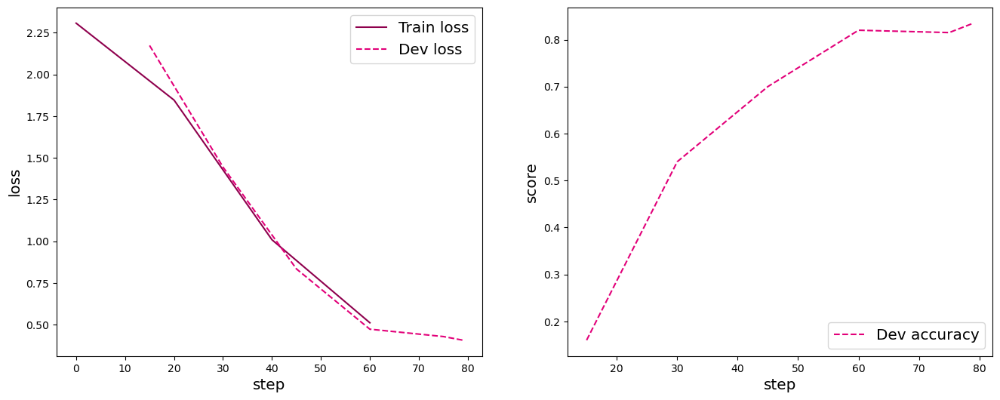

In [21]:
from nndl_5 import plot_training_loss_acc
plot_training_loss_acc(runner, 'cnn_loss1.pdf')

In [22]:
# 加载最优模型
runner.load_model('best_model_RunnerV3_MINIST.pdparams')
# 模型评价
score, loss = runner.evaluate(test_loader)
print(f'[Test] accuracy/loss:{score:.4f}/{loss:.4f}')

Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [64, 28, 28]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Conv2D in_channels: 6 i: 3 single: [64, 10, 10]
Conv2D in_channels: 6 i: 4 single: [64, 10, 10]
Conv2D in_channels: 6 i: 5 single: [64, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [64, 10, 10]
Conv2D in_channels: 6 i: 0 single: [64, 10, 1

C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [64, 28, 28]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Conv2D in_channels: 6 i: 3 single: [64, 10, 10]
Conv2D in_channels: 6 i: 4 single: [64, 10, 10]
Conv2D in_channels: 6 i: 5 single: [64, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [64, 10, 10]
Conv2D in_channels: 6 i: 0 single: [64, 10, 1

Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 0 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 1 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 2 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 3 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 4 feature_map: [64, 28, 28]
Conv2D in_channels: 1 i: 0 single: [64, 28, 28]
Conv2D out_channels: 6 p: 5 feature_map: [64, 28, 28]
Conv2D in_channels: 6 i: 0 single: [64, 10, 10]
Conv2D in_channels: 6 i: 1 single: [64, 10, 10]
Conv2D in_channels: 6 i: 2 single: [64, 10, 10]
Conv2D in_channels: 6 i: 3 single: [64, 10, 10]
Conv2D in_channels: 6 i: 4 single: [64, 10, 10]
Conv2D in_channels: 6 i: 5 single: [64, 10, 10]
Conv2D out_channels: 16 p: 0 feature_map: [64, 10, 10]
Conv2D in_channels: 6 i: 0 single: [64, 10, 1

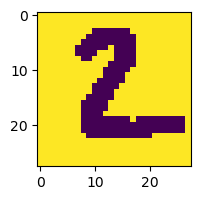

In [27]:
# 模型预测
# 获取测试集中第一条数据
X, label = next(test_loader())
logits = runner.predict(X)
# 多分类，使用softmax计算预测概率
pred = F.softmax(logits)
# 获取概率最大的类别
pred_class = paddle.argmax(pred[1]).numpy()
label = label[1][0].numpy()
# 输出真实类别与预测类别
print(f"The true category is {label[0]} and the predicted category is {pred_class[0]}")

# 可视化图片
plt.figure(figsize=(2,2))
image, label = test_set[0][1], test_set[1][1]
image = np.array(image).astype('float32')
image = np.reshape(image, [28,28])
image = Image.fromarray(image.astype('uint8'), mode='L')
plt.imshow(image)
plt.savefig('conv-number2.pdf')

基于残差网络的手写体数字识别实验

In [28]:
class ResBlock(nn.Layer):
    def __init__(self, in_channels, out_channels, stride=1, use_residual=True):
        """
        残差单元
        输入：
            - in_channels：输入通道数
            - out_channels：输出通道数
            - stride：残差单元的步长，通过调整残差单元中第一个卷积层的步长来控制
            - use_residual：用于控制是否使用残差连接
        """
        super(ResBlock, self).__init__()
        self.stride = stride
        self.use_residual = use_residual
        # 第一个卷积层，卷积核大小为3×3，可以设置不同输出通道数以及步长
        self.conv1 = nn.Conv2D(in_channels, out_channels, 3, padding=1, stride=self.stride, bias_attr=False)
        # 第二个卷积层，卷积核大小为3×3，不改变输入特征图的形状，步长为1
        self.conv2 = nn.Conv2D(out_channels, out_channels, 3, padding=1, bias_attr=False)

        # 如果conv2的输出和此残差块的输入数据形状不一致，则use_1x1conv = True
        # 当use_1x1conv = True，添加1个1x1的卷积作用在输入数据上，使其形状变成跟conv2一致
        if in_channels != out_channels or stride != 1:
            self.use_1x1conv = True
        else:
            self.use_1x1conv = False
        # 当残差单元包裹的非线性层输入和输出通道数不一致时，需要用1×1卷积调整通道数后再进行相加运算
        if self.use_1x1conv:
            self.shortcut = nn.Conv2D(in_channels, out_channels, 1, stride=self.stride, bias_attr=False)
        
        # 每个卷积层后会接一个批量规范化层，批量规范化的内容在7.5.1中会进行详细介绍,
        self.bn1 = nn.BatchNorm2D(out_channels)
        self.bn2 = nn.BatchNorm2D(out_channels)
        if self.use_1x1conv:
            self.bn3 = nn.BatchNorm2D(out_channels)

    def forward(self, inputs):
        y = F.relu(self.bn1(self.conv1(inputs)))
        y = self.bn2(self.conv2(y))
        if self.use_residual:
            if self.use_1x1conv:
                # 如果为真，对inputs进行1×1卷积，将形状调整成跟conv2的输出y一致
                shortcut  = self.shortcut(inputs)
                shortcut = self.bn3(shortcut)
            else:
                # 否则直接将inputs和conv2的输出y相加
                shortcut =inputs
            y = paddle.add(shortcut, y)
        out = F.relu(y)
        return out



In [29]:
# 残差网络就是将很多个残差单元串联起来构成的一个非常深的网络。ResNet18 的网络结构

def make_first_module(in_channels):
    # 模块一：7*7卷积、批量规范化、池化
    # nn.Sequential类来实现简单的顺序连接模型
    m1 = nn.Sequential(nn.Conv2D(in_channels=in_channels, out_channels=64, kernel_size=7, stride=2, padding=3),
                       nn.BatchNorm2D(64),
                       nn.ReLU(),
                       nn.MaxPool2D(kernel_size=3, stride=2, padding=1))
    return m1

In [50]:
def resnet_module(input_channels, out_channels, num_res_blocks, stride=1, use_residual=True):
    blk = []
    # 根据num_res_blocks，循环生成残差单元
    for i in range(num_res_blocks):
        if i == 0:
            # 创建模块中的第一个残差单元
            blk.append(ResBlock(in_channels=input_channels, out_channels=out_channels, stride=stride, use_residual=use_residual))
        else:
            # 创建模块中的其他残差单元
            blk.append(ResBlock(in_channels=out_channels, out_channels=out_channels, use_residual=use_residual))
    return blk

In [51]:
# 封装模块二到模块五。
def make_modules(use_residual):
    # 模块二：包含两个残差单元，输入通道数为64，输出通道数为64，步长为1，特征图大小保持不变
    m2 = nn.Sequential(*resnet_module(64, 64, num_res_blocks=2, stride=1, use_residual=use_residual))
    # 模块三：包含两个残差单元，输入通道数为64，输出通道数为128，步长为2，特征图大小缩小一半。
    m3 = nn.Sequential(*resnet_module(64, 128, num_res_blocks=2, stride=2, use_residual=use_residual))
    # 模块四：包含两个残差单元，输入通道数为128，输出通道数为256，步长为2，特征图大小缩小一半。
    m4 = nn.Sequential(*resnet_module(128, 256, num_res_blocks=2, stride=2, use_residual=use_residual))
    # 模块五：包含两个残差单元，输入通道数为256，输出通道数为512，步长为2，特征图大小缩小一半。
    m5 = nn.Sequential(*resnet_module(256, 512, num_res_blocks=2, stride=2, use_residual=use_residual))
    return m2, m3, m4, m5

In [53]:
# 定义完整网络
class Model_ResNet18(nn.Layer):
    def __init__(self, in_channels=3, num_classes=10, use_residual=True):
        super(Model_ResNet18, self).__init__()
        m1 = make_first_module(in_channels)
        m2, m3, m4, m5 = make_modules(use_residual)
        # 封装模块一到模块6
        self.net = nn.Sequential(m1, m2, m3, m4, m5, nn.AdaptiveAvgPool2D(1), nn.Flatten(), nn.Linear(512, num_classes))

    def forward(self, x):
        return self.net(x)

In [54]:
model = Model_ResNet18(in_channels=1, num_classes=10, use_residual=True)
params_info = paddle.summary(model, (1, 1, 32, 32))
print(params_info)

-------------------------------------------------------------------------------
   Layer (type)         Input Shape          Output Shape         Param #    
     Conv2D-73        [[1, 1, 32, 32]]     [1, 64, 16, 16]         3,200     
  BatchNorm2D-46     [[1, 64, 16, 16]]     [1, 64, 16, 16]          256      
      ReLU-7         [[1, 64, 16, 16]]     [1, 64, 16, 16]           0       
   MaxPool2D-11      [[1, 64, 16, 16]]      [1, 64, 8, 8]            0       
     Conv2D-74        [[1, 64, 8, 8]]       [1, 64, 8, 8]         36,864     
  BatchNorm2D-47      [[1, 64, 8, 8]]       [1, 64, 8, 8]           256      
     Conv2D-75        [[1, 64, 8, 8]]       [1, 64, 8, 8]         36,864     
  BatchNorm2D-48      [[1, 64, 8, 8]]       [1, 64, 8, 8]           256      
    ResBlock-19       [[1, 64, 8, 8]]       [1, 64, 8, 8]            0       
     Conv2D-76        [[1, 64, 8, 8]]       [1, 64, 8, 8]         36,864     
  BatchNorm2D-49      [[1, 64, 8, 8]]       [1, 64, 8, 8]     

C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\nn\layer\norm.py:712: UserWarning: When training, we now always track global mean and variance.
  warnings.warn(


[Train] epoch: 0/5, step: 0/80, loss: 2.58566
[Train] epoch: 0/5, step: 15/80, loss: 1.58868
[Evaluate]  dev score: 0.13000, dev loss: 2.28061
[Evaluate] best accuracy performence has been updated: 0.00000 --> 0.13000


C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


[Train] epoch: 1/5, step: 30/80, loss: 1.01399
[Evaluate]  dev score: 0.62500, dev loss: 1.47624
[Evaluate] best accuracy performence has been updated: 0.13000 --> 0.62500
[Train] epoch: 2/5, step: 45/80, loss: 0.60294
[Evaluate]  dev score: 0.73000, dev loss: 0.85399
[Evaluate] best accuracy performence has been updated: 0.62500 --> 0.73000
[Train] epoch: 3/5, step: 60/80, loss: 0.28288
[Evaluate]  dev score: 0.76000, dev loss: 0.69486
[Evaluate] best accuracy performence has been updated: 0.73000 --> 0.76000
[Train] epoch: 4/5, step: 75/80, loss: 0.10657
[Evaluate]  dev score: 0.82000, dev loss: 0.54788
[Evaluate] best accuracy performence has been updated: 0.76000 --> 0.82000
[Evaluate]  dev score: 0.84500, dev loss: 0.54820
[Evaluate] best accuracy performence has been updated: 0.82000 --> 0.84500
[Train] Training done!


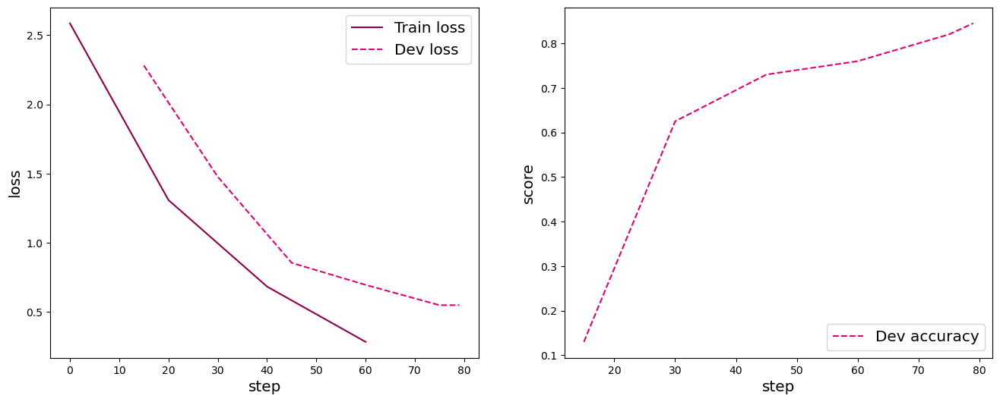

In [55]:
# 没有残差连接的ResNet18
from nndl_5 import plot

paddle.seed(100)
# 学习率大小
lr = 0.005
# 批次大小
batch_size = 64
# 加载数据
train_loader = io.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
dev_loader = io.DataLoader(dev_dataset, batch_size=batch_size)
test_loader = io.DataLoader(test_dataset, batch_size=batch_size)

# 定义网络，不使用残差结构的深层网络
model = Model_ResNet18(in_channels=1, num_classes=10, use_residual=False)
# 定义优化器
optimizer = opt.SGD(learning_rate=lr, parameters=model.parameters())
runner = RunnerV3(model, optimizer, loss_fn, metric)

# 启动训练
log_steps = 15
eval_steps = 15
runner.train(train_loader, dev_loader, num_epochs=5, log_steps=log_steps, eval_steps=eval_steps, save_path='best_model_RunnerV3_NoResNet18.pdparams')
# 可视化观察训练集与验证集的Loss变化情况
plot_training_loss_acc(runner, 'cnn-loss2.pdf')


In [56]:
# 加载最优模型
runner.load_model('best_model_RunnerV3_NoResNet18.pdparams')
# 模型评价
score, loss = runner.evaluate(test_loader)
print("[Test] accuracy/loss: {:.4f}/{:.4f}".format(score, loss))

[Test] accuracy/loss: 0.7950/0.6465


C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\nn\layer\norm.py:712: UserWarning: When training, we now always track global mean and variance.
  warnings.warn(


[Train] epoch: 0/5, step: 0/80, loss: 3.66975
[Train] epoch: 0/5, step: 15/80, loss: 0.73178
[Evaluate]  dev score: 0.62000, dev loss: 1.16370
[Evaluate] best accuracy performence has been updated: 0.00000 --> 0.62000


C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


[Train] epoch: 1/5, step: 30/80, loss: 0.16933
[Evaluate]  dev score: 0.82500, dev loss: 0.52748
[Evaluate] best accuracy performence has been updated: 0.62000 --> 0.82500
[Train] epoch: 2/5, step: 45/80, loss: 0.02084
[Evaluate]  dev score: 0.81500, dev loss: 0.43829
[Train] epoch: 3/5, step: 60/80, loss: 0.01375
[Evaluate]  dev score: 0.80500, dev loss: 0.41525
[Train] epoch: 4/5, step: 75/80, loss: 0.00879
[Evaluate]  dev score: 0.81500, dev loss: 0.40435
[Evaluate]  dev score: 0.80500, dev loss: 0.40837
[Train] Training done!


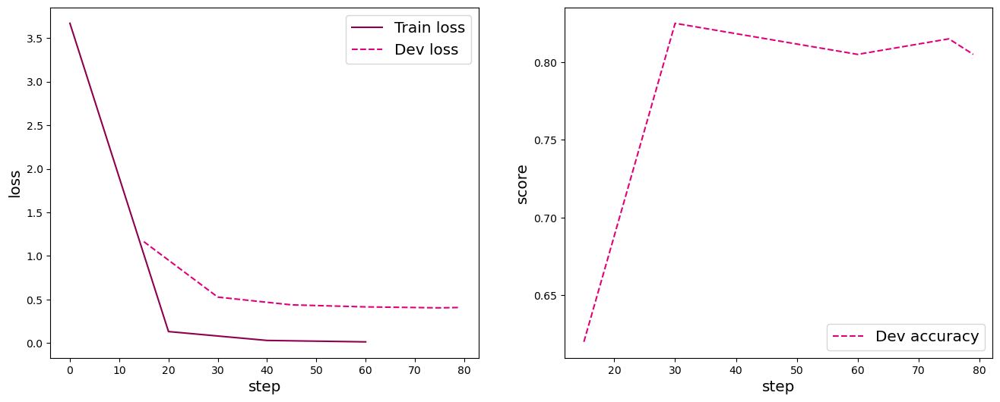

In [57]:
# 带残差连接的ResNet18
# 学习率大小
lr = 0.01
# 批次大小
batch_size = 64
# 加载数据
train_loader = io.DataLoader(train_dataset, batch_size=64, shuffle=True)
dev_loader = io.DataLoader(dev_dataset, batch_size=64)
test_loader = io.DataLoader(test_dataset, batch_size=batch_size)

# 定义网络，通过指定use_residual为True，使用残差结构的深层网络
model = Model_ResNet18(in_channels=1, num_classes=10, use_residual=True)
# 定义优化器
optimizer = opt.SGD(learning_rate=lr, parameters=model.parameters())
# 实例化RunnerV3
runner = RunnerV3(model, optimizer, loss_fn, metric)
# 启动训练
log_steps = 15
eval_steps = 15
runner.train(train_loader, dev_loader, num_epochs=5, log_steps=log_steps,eval_steps=eval_steps,save_path='best_model_RunnerV3_ResNet18.pdparams')
# 可视化观察训练集与验证集的Loss变化情况
plot_training_loss_acc(runner,'cnn-loss3.pdf')


In [58]:
# 加载最优模型
runner.load_model('best_model_RunnerV3_ResNet18.pdparams')

# 模型评价
score, loss = runner.evaluate(test_loader)
print(f"[Test] accuracy/loss: {score:.4f}/{loss:.4f}")

[Test] accuracy/loss: 0.8250/0.5434


C:\Users\Dragon_Reed\AppData\Roaming\Python\Python310\site-packages\paddle\fluid\dygraph\math_op_patch.py:275: UserWarning: The dtype of left and right variables are not the same, left dtype is paddle.int64, but right dtype is paddle.int32, the right dtype will convert to paddle.int64
  warnings.warn(


In [71]:
# 与高层API实现版本的对比实验
from paddle.vision.models import resnet18
import warnings
warnings.filterwarnings("ignore")

# 使用飞桨HAPI中实现的resnet18模型，该模型默认输入通道数为3，输出类别数1000
hapi_model = resnet18()
# 自定义的resnet18模型
model = Model_ResNet18(in_channels=3, num_classes=1000, use_residual=True)

# 获取网络的权重
params = hapi_model.state_dict()
# 用来保存参数名映射后的网络权重
new_params = {}
# 将参数名进行映射
for key in params:
    # print(key)
    # print(key[1:3])
    if 'layer' in key:
        if 'downsample.0' in key:
            new_params['net.' + key[5:8] + '.shortcut' + key[-7:]] = params[key]
            # print(params[key])
        elif 'downsample.1' in key:
            new_params['net.' + key[5:8] + '.shortcut' + key[23:]] = params[key]
        else:
            new_params['net.' + key[5:]] = params[key]
    elif 'conv1.weight' == key:
        new_params['net.0.0.weight'] = params[key]
    elif 'bn1' in key:
        new_params['net.0.1' + key[3:]] = params[key]
    elif 'fc' in key:
        new_params['net.7' + key[2:]] = params[key]

print(new_params)

# 将飞桨HAPI中实现的resnet18模型的权重参数赋予自定义的resnet18模型，保持两者一致
model.set_state_dict(new_params)

# 这里用np.random创建一个随机数组作为测试数据
inputs = np.random.randn(*[1, 3, 32, 32])
inputs = inputs.astype('float32')
x = paddle.to_tensor(inputs)

output = model(x)
hapi_out = hapi_model(x)

# 计算两个模型输出差异、
diff = output - hapi_out
max_diff = paddle.max(diff)
print(max_diff)

conv1.weight
bn1.weight
bn1.bias
bn1._mean
bn1._variance
layer1.0.conv1.weight
layer1.0.bn1.weight
layer1.0.bn1.bias
layer1.0.bn1._mean
layer1.0.bn1._variance
layer1.0.conv2.weight
layer1.0.bn2.weight
layer1.0.bn2.bias
layer1.0.bn2._mean
layer1.0.bn2._variance
layer1.1.conv1.weight
layer1.1.bn1.weight
layer1.1.bn1.bias
layer1.1.bn1._mean
layer1.1.bn1._variance
layer1.1.conv2.weight
layer1.1.bn2.weight
layer1.1.bn2.bias
layer1.1.bn2._mean
layer1.1.bn2._variance
layer2.0.conv1.weight
layer2.0.bn1.weight
layer2.0.bn1.bias
layer2.0.bn1._mean
layer2.0.bn1._variance
layer2.0.conv2.weight
layer2.0.bn2.weight
layer2.0.bn2.bias
layer2.0.bn2._mean
layer2.0.bn2._variance
layer2.0.downsample.0.weight
layer2.0.downsample.1.weight
layer2.0.downsample.1.bias
layer2.0.downsample.1._mean
layer2.0.downsample.1._variance
layer2.1.conv1.weight
layer2.1.bn1.weight
layer2.1.bn1.bias
layer2.1.bn1._mean
layer2.1.bn1._variance
layer2.1.conv2.weight
layer2.1.bn2.weight
layer2.1.bn2.bias
layer2.1.bn2._mean
layer